# Attenuated Signal Test Example

This notebook demonstrates an example of how an attenuation test can be used to detect biofouling on an instrument.

The source data is derived from a historical USGS CTD station located at Lower Sand Island, OR in the Columbia River estuary.
The selected time period shows the tidal influence on salinity over a spring-neap time period.
Near the end of the selected period, there is a decrease in the range of salinity corresponding with biofouling.

The data was downloaded from the [Center for Coastal Margin and Prediction (CMOP) Data Explorer](https://amb6400b.stccmop.org/ws/product/offeringplot_ctime.py?handlegaps=true&series=time,sandi.790.A.CTD.salt.PD0&width=8.54&height=2.92&starttime=2001-7-1%200:00&endtime=2001-09-5%2023:59).

### Setup

In [1]:
from bokeh import plotting

plotting.output_notebook()

Loading BokehJS ...

In [2]:
import numpy as np
from bokeh.layouts import gridplot


def plot_results(data, var_name, results, title, test_name):
    time = data.index
    obs = data[var_name]
    qc_test = results["qartod"][test_name]

    qc_pass = np.ma.masked_where(qc_test != 1, obs)
    qc_suspect = np.ma.masked_where(qc_test != 3, obs)
    qc_fail = np.ma.masked_where(qc_test != 4, obs)
    qc_notrun = np.ma.masked_where(qc_test != 2, obs)

    p1 = plotting.figure(x_axis_type="datetime", title=test_name + " : " + title)
    p1.grid.grid_line_alpha = 0.3
    p1.xaxis.axis_label = "Time"
    p1.yaxis.axis_label = "Observation Value"

    p1.line(time, obs, legend_label="obs", color="#A6CEE3")
    p1.circle(
        time,
        qc_notrun,
        size=2,
        legend_label="qc not run",
        color="gray",
        alpha=0.2,
    )
    p1.circle(time, qc_pass, size=4, legend_label="qc pass", color="green", alpha=0.5)
    p1.circle(
        time,
        qc_suspect,
        size=4,
        legend_label="qc suspect",
        color="orange",
        alpha=0.7,
    )
    p1.circle(time, qc_fail, size=6, legend_label="qc fail", color="red", alpha=1.0)
    p1.circle(
        time,
        qc_notrun,
        size=6,
        legend_label="qc not eval",
        color="gray",
        alpha=1.0,
    )

    plotting.show(gridplot([[p1]], width=800, height=400))

## Run example

#### 1. Load data and perform exploratory analysis

Historical salinity [data from Lower Sand Island, Columbia River Estuary](http://amb6400b.stccmop.org/ws/product/offeringplot_ctime.py?handlegaps=true&series=time,sandi.790.A.CTD.salt.PD0&width=8.54&height=2.92&starttime=2001-7-1%200:00&endtime=2001-09-5%2023:59). The location is the same as [sandi for CREOFS](https://tidesandcurrents.noaa.gov/ofs/ofs_station.html?stname=Lower%20Sand%20Island%20Light&ofs=cre&stnid=sandi&subdomain=ba).

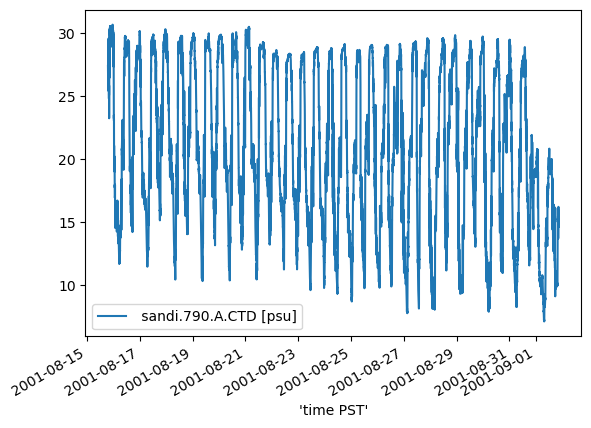

In [3]:
import pandas as pd

url = "https://github.com/ioos/ioos_qc/raw/master/docs/source/examples"
fname = f"{url}/attenuated_salinity_example.csv"

data = pd.read_csv(fname, header=1, index_col="'time PST'", parse_dates=True)
data.plot();

In [4]:
var_name = data.columns[0]
data[var_name]

'time PST'
2001-08-15 19:06:55    27.37
2001-08-15 19:07:55    27.03
2001-08-15 19:08:55    26.78
2001-08-15 19:09:55    26.73
2001-08-15 19:10:55    27.10
                       ...  
2001-09-01 20:51:57    15.71
2001-09-01 20:52:57    15.48
2001-09-01 20:53:57    15.46
2001-09-01 20:54:57    15.56
2001-09-01 20:55:57    14.61
Name:  sandi.790.A.CTD [psu], Length: 24436, dtype: float64

#### 2. Plot range and standard deviation of salinity over M2 moving window

In [5]:
# lunar day (M2)
time_delta = 3600 * 24.8
print(f"window: {time_delta}")

# start QC after half a tidal day
min_period_secs = time_delta / 2

# one obs per minute
min_period_obs = time_delta / 2 / 60

# pandas uses phrase "min_periods" to indicate minimum number of observations in the window
# - ioos_qc uses the phrase "min_period" to indicate minimum number of seconds in the window
# Depending on your use case, you can define the period in number of observations or number of seconds
print(f"min_period (secs): {min_period_secs}")
print(f"min_period (num obs): {min_period_obs}")

window: 89280.0
min_period (secs): 44640.0
min_period (num obs): 744.0


Range check.

/tmp/ipykernel_304753/2965508739.py:1: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
  range_data = data.rolling(f"{time_delta}S", min_periods=int(min_period_obs)).apply(


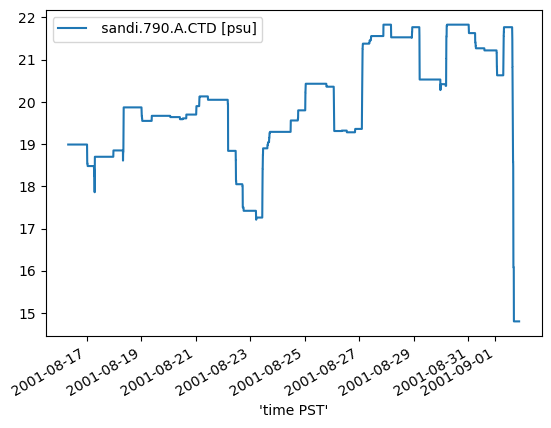

In [6]:
range_data = data.rolling(f"{time_delta}S", min_periods=int(min_period_obs)).apply(
    np.ptp,
    raw=True,
)

range_data.plot();

Check that min_{periods, obs} are NaN

- note that N-1 are NaNs

In [7]:
range_data.isna().sum()

sandi.790.A.CTD [psu]    743
dtype: int64

Standard deviation check.

/tmp/ipykernel_304753/708233194.py:1: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
  stdev_data = data.rolling(f"{time_delta}S", min_periods=int(min_period_obs)).apply(


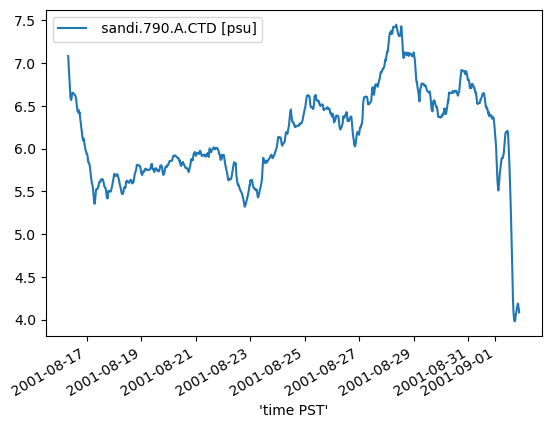

In [8]:
stdev_data = data.rolling(f"{time_delta}S", min_periods=int(min_period_obs)).apply(
    np.std,
    raw=True,
)

stdev_data.plot();

#### 3. Run QC and plot results

##### Test range

The beginning 743 points (`min_period`) are marked as "NOT EVALUATED" because there is not enough data yet to evaluate whether they are pass or fail.

The range of the signal falls so quickly that no points are marked as "SUSPECT", but immediately change from "PASS" to "FAIL".

In [9]:
from ioos_qc.config import QcConfig

qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 17.25,
            "fail_threshold": 15,
            "test_period": int(time_delta),
            "min_period": min_period_secs,
            "check_type": "range",
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"

p1 = plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

##### Test standard deviation

The "standard deviation" test picks up likely suspect data whereas the "range" test did not.
The exemplifies the utility of using both tests in tandem.

In [10]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 5,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": min_period_secs,
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

## Sensitivity Tests


### 1. Test results sensitivity to `min_period`

The following plots demonstrate the sensitivity of the test results in the beginning of a time series to the selection of `min_period`. 


### `min_period`: 0

No observations are marked suspect at the beginning of the time series, but the first 744 observations (the size of the rolling window) are labeled "FAILING".

In [11]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 5,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": 0,
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

### `min_period`: 10min

Only the first 10s observations are marked as NOT EVALUATED, but the remainder of the first 744 samples are labeled as "FAILING".

In [12]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 5,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": 10 * 60,
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

### `min_period`: 1h

In [13]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 5,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": 60 * 60,
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

### `min_period`: test_period/2

The first 744 samples are marked "NOT EVALUATED", but none are marked as "FAILING".

In [14]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 5,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": int(time_delta / 2),
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

### 2. Test results sensitivity to `suspect_threshold`.


### `suspect_threshold`: 7

In [15]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 7,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": min_period_secs,
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

### `suspect_threshold`: 6

In [16]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 6,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": min_period_secs,
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")

### `suspect_threshold`: 5

In [17]:
qc_config = {
    "qartod": {
        "attenuated_signal_test": {
            "suspect_threshold": 5,
            "fail_threshold": 4.5,
            "check_type": "std",
            "test_period": int(time_delta),
            "min_period": min_period_secs,
        },
    },
}
qc = QcConfig(qc_config)
qc_results = qc.run(inp=data[var_name], tinp=data.index.values)

title = "Salinity [psu] : Lower Sand Island, OR"
plot_results(data, var_name, qc_results, title, "attenuated_signal_test")